## MIIA-4203 MODELOS AVANZADOS PARA ANÁLISIS DE DATOS II


# Aprendizaje por transferencia con redes neuronales 


### Profesor: Camilo Franco (c.franco31@uniandes.edu.co)

En este cuadernos estudiaremos una implementación de aprendizaje por transferencia utilizando la red pre-entrenada VGG-16. Implementaremos nuestra propio modelo de aprendizaje por trasferencia utilizando la biblioteca (API) Keras (https://keras.io/). 

Finalmente evaluaremos si un modelo más complejo de *deep learning* nos permite lograr un mejor desempeño para la detección automática de frailejones sobre imagenes aereas del páramo.

Primero importemos algunos de los paquetes que vamos a utilizar, junto con las imagenes de entrenamiento:


In [1]:
import numpy as np
import h5py
import matplotlib.pyplot as plt

from ImportImagenesRGB import *
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix 

%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

from prettytable import PrettyTable
import datetime

import keras
from keras.models import Sequential, load_model
from keras.optimizers import SGD
from keras.layers import Conv2D, MaxPooling2D, Activation, Dropout, Flatten, Dense
from keras import applications

from numpy.random import seed
seed(1)

import tensorflow as tf
tf.random.set_seed(1)

In [2]:
X,Y = import_imagenes_RGB()

print(X.shape, Y.shape, X[0,0,0])

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


**Salida esperada:**

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


## 1. Aprendizaje por transferencia

En pocas palabras, el aprendizaje por transferencia tiene su historia en la psicología, refiriendose a situaciones donde las personas aplican concimiento, estrategias y aptitudes que han aprendido previamente para enfrentar una nueva situación bajo un contexto **relacionado**. Dentro del aprendizaje computacional, este tipo de aprendizaje se enfoca en guardar un tipo de conocimiento que ya se ha mostrado útil para resolver un problema, y aplicarlo para resolver otro problema distinto pero **relacionado**.

Hay que tener en cuenta que si un modelo de transferencia tiene un efecto negativo sobre el desempeño del modelo, entonces tendremos una transferencia negativa (lo cual no es deseable). De este modo, el reto de los métodos de transferencia es el de producir una transferencia positiva entre tareas apropiadamente relacionadas, evitando transferencias negativas entre tareas poco relacionadas (ver Torrey & Shavlik (2009) Transfer learning). 

El ejemplo que vamos a ver a continuación es un tipo de aprendizaje por transferencia inductivo, característico de las redes neuronales, el cual se ajusta de acuerdo con la coincidencia de un conocimiento previo sobre la fuente de información y la tarea que se propone solucionar. En particular, vamos a llevar a cabo un *aprendizaje por transferencia inductivo-jerárquico*, buscando soluciones a tareas sencillas mediante la combinación de herramientas desarrolladas para tareas más complejas. Entonces, usamos el aprendizaje de una red pre-entrenada, la VGG-16, para aprovechar su conocimiento sobre formas, contornos, bordes, etc. que podemos hacer propias para terminar de entender mejor el problema de clasificación de frailejones, y esperamos mejorar el desempeño de los modelos.


### VGG-16

La red VGG-16 fue propuesta por Simonyan & Zisserman (2015) en Very deep CNN for large-scale image recognition, siguiendo los principios presentados en Ciresan et al. (2011): Flexible, High Performance Convolutional Neural Networks for Image Classification.

La arquitectura de la VGG-16 le permitió ganar la competición ILSVR(Imagenet) 2014 (http://www.image-net.org/challenges/LSVRC/2014/results). Los principios de esta arquitectura consisten en considerar filtros convolucionales pequeños (de $3\times 3$), que recorren las imagenes exhaustivamente, con un *stride* de 1, y capas de *max-poling* de $2\times 2$, reduciendo en gran medida el número de hiper-parámetros a optimizar. La red VGG-16 es bastante profunda, con una configuración de 16 capas (con aprox. 138 millones de parámetros): para las primeras 14 capas combina capas convolucionales y capas de agregación, y al final tiene 2 capa densamente conectadas seguidas de una capa de salida *softmax* para clasificación de múltiples clases (ver: https://neurohive.io/en/popular-networks/vgg16/).


Implementemos nuestro ejemplo de aprendizaje por transferencia utilizando la red VGG-16, la cual ha sido entrenada previamente con imagenes RGB y que podemos descargar directamente de Keras:

In [3]:
model0 = applications.VGG16(include_top=False, weights='imagenet')
config_transI = model0.get_config()

Pasamos nuestro conjunto de datos por la red, obteniendo los nuevos patrones de acuerdo con el entendimiento de la red convolucional VGG-16 acerca de las nociones más básicas que encuentra en nuestras imagenes del Páramo:

In [4]:
feat_X = model0.predict(X)

In [5]:
print(feat_X.shape, Y.shape)

(250, 2, 2, 512) (1, 250)


Agregamos unas pocas capas finales para afinar el modelo por transferencia para la tarea específica de detección de imagenes aereas del Páramo:

In [6]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

Y entrenamos esas capas finales:

In [7]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        try:
            pathr =('Transfer_Adam_partseed='+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p
        except:
            continue
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.973  | 0.9211 |   99  |
|  1.0   | 0.973  | 0.9211 |   99  |
+--------+--------+--------+-------+


Graficamos el desempeño del modelo:

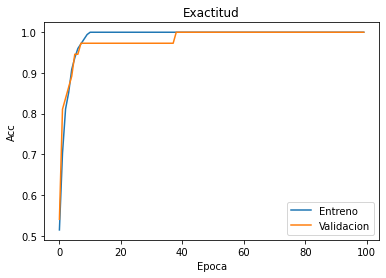

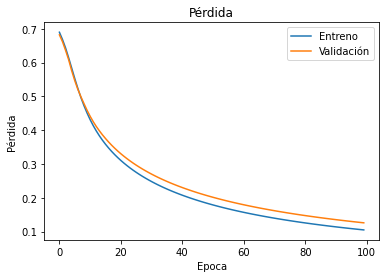

In [8]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

Cargamos el mejor modelo y confirmamos el desempeño del modelo sobre todo el conjunto de datos:

In [9]:
# red convolucional
model_4 = load_model('Transfer_Adam_partseed=1.h5')

model_4.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 10245     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


Veamos el desempeño del mejor modelo sobre todo el conjunto de datos:

In [10]:
Y_pred = model_4.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

**Salida esperada:**
    
<table style="width:20%">
    <tr>
       <td> 144 </td>
       <td> 1 </td>
    </tr>
    <tr>
       <td> 0 </td>
       <td> 105 </td>
    </tr>

</table>

Podemos observar que el desempeño del modelo a mejorado bastante. 

### Ejercicio 1.1

Encuentre el mejor modelo examinando una configuración distinta para las capas de salida, o siguiendo alguna otra estrategia como puede ser cambiando el optimizador o las funciones de activación.

In [11]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_norm_transF = model.get_config()

In [12]:
#inicializacion de He
initHe = keras.initializers.he_normal(seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initHe, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initHe, bias_initializer='zeros')) 

config_He_transF = model.get_config()

Inicio Init=Normal:2020-09-26 11:08:53.095632
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
Fin Init= Normal:2020-09-26 11:09:02.200055
Transfer_Adam_partseed=Normal3.h5


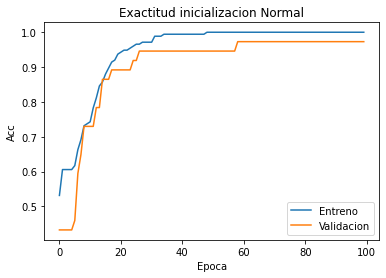

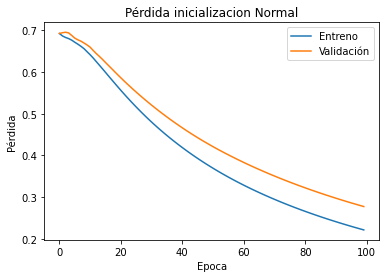

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
+--------+--------+--------+-------+--------+
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964
Fin Init= Normal:2020-09-26 11:09:12.158392
Transfer_Adam_partseed=Normal2.h5


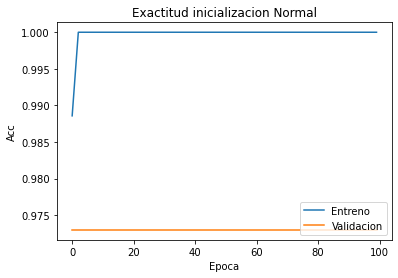

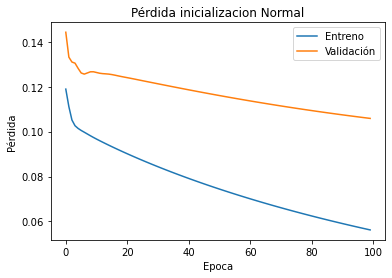

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
|  1.0   | 0.973  | 0.9737 |   99  | Normal |
+--------+--------+--------+-------+--------+
Epoca= 99 , accu_v1=1.0 , accu_v2=1.0
Fin Init= Normal:2020-09-26 11:09:22.362878
Transfer_Adam_partseed=Normal1.h5


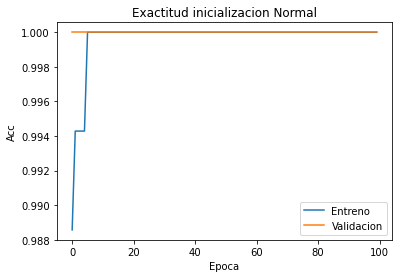

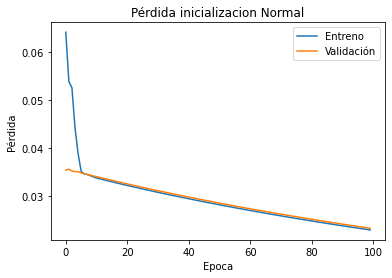

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
|  1.0   | 0.973  | 0.9737 |   99  | Normal |
|  1.0   |  1.0   |  1.0   |   99  | Normal |
+--------+--------+--------+-------+--------+
Inicio Init=He:2020-09-26 11:09:23.122760
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
Fin Init= He:2020-09-26 11:09:32.744094
Transfer_Adam_partseed=Normal1.h5


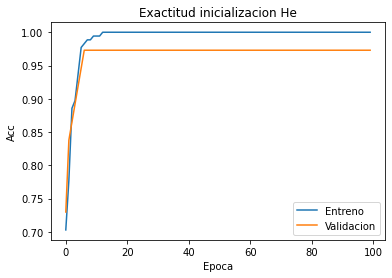

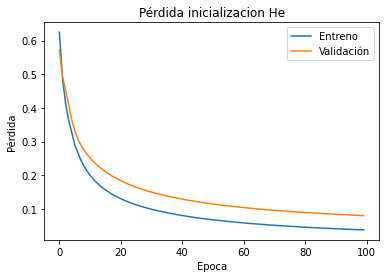

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
|  1.0   | 0.973  | 0.9737 |   99  | Normal |
|  1.0   |  1.0   |  1.0   |   99  | Normal |
|  1.0   | 0.973  | 0.9211 |   99  |   He   |
+--------+--------+--------+-------+--------+
Epoca= 5 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964
Fin Init= He:2020-09-26 11:09:38.976842
Transfer_Adam_partseed=Normal1.h5


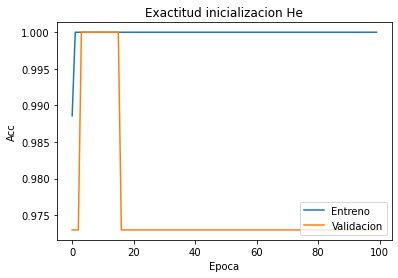

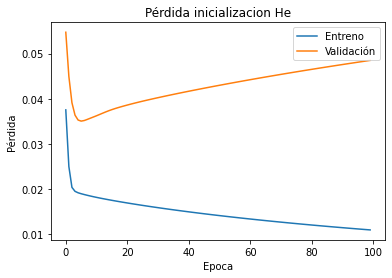

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
|  1.0   | 0.973  | 0.9737 |   99  | Normal |
|  1.0   |  1.0   |  1.0   |   99  | Normal |
|  1.0   | 0.973  | 0.9211 |   99  |   He   |
|  1.0   | 0.973  | 0.9737 |   5   |   He   |
+--------+--------+--------+-------+--------+
Epoca= 99 , accu_v1=1.0 , accu_v2=1.0
Fin Init= He:2020-09-26 11:09:49.203970
Transfer_Adam_partseed=He1.h5


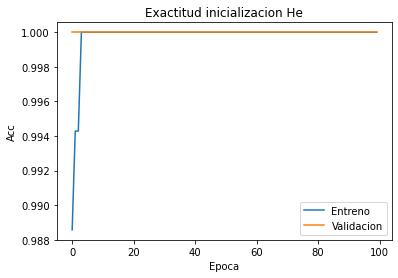

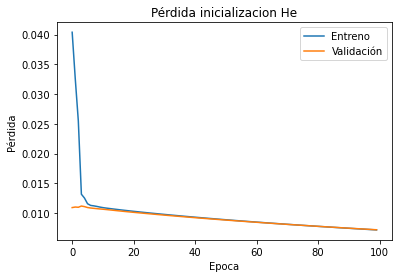

+--------+--------+--------+-------+--------+
| Exac_E | Exac_V | Exac_P | Epoca |  Init  |
+--------+--------+--------+-------+--------+
|  1.0   | 0.973  | 0.9211 |   99  | Normal |
|  1.0   | 0.973  | 0.9737 |   99  | Normal |
|  1.0   |  1.0   |  1.0   |   99  | Normal |
|  1.0   | 0.973  | 0.9211 |   99  |   He   |
|  1.0   | 0.973  | 0.9737 |   5   |   He   |
|  1.0   |  1.0   |  1.0   |   99  |   He   |
+--------+--------+--------+-------+--------+


In [13]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Init"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

# implementamos 2 repeticiones, una con inicializacion aleatoria Normal y otra con He
for i in range(2):
    if(i==0):
        model = Sequential.from_config(config_norm_transF)
        init = "Normal"
        tiempo0 = datetime.datetime.now()
        print('Inicio Init=' +str(init)+':' +str(tiempo0))
    elif(i==1):
        model = Sequential.from_config(config_He_transF)
        init = "He"
        tiempo0 = datetime.datetime.now()
        print('Inicio Init=' +str(init)+':' +str(tiempo0))

    for i in range(0,3,1):
        r = i^3
        CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
        CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)

        # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
        model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])

        # Ajustamos el modelo
        history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Encontramos el mejor modelo en validación
        min_err=np.min(history.history['val_loss'])
        best_epoc=np.where(history.history['val_loss'] == min_err)[0] 

        # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
        model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Calculamos las metricas
        train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
        valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
        test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)

        # Guardamos las métricas de desempeño
        accu_e = train_metrics[1]
        loss_e = train_metrics[0]
        accu_v = valid_metrics[1]
        loss_v = valid_metrics[0]
        accu_p = test_metrics[1]
        loss_p = test_metrics[0]

        if (loss_p < err_p):
            try:
                pathr =('Transfer_Adam_partseed='+str(init)+str(r)+'.h5')
                model.save(pathr) 
                err_p = loss_p
            except:
                continue

        # Imprimimos el desempeño para cada repetición
        print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
        tiempo1 = datetime.datetime.now()
        print('Fin Init= ' +str(init)+':' +str(tiempo1))
        print(pathr)

        x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], init])

        # Graficamos el desempeño del modelo
        plt.figure(1)
        plt.plot(history.history['accuracy'])  
        plt.plot(history.history['val_accuracy'])  
        plt.title('Exactitud inicializacion ' +str(init))  
        plt.ylabel('Acc')  
        plt.xlabel('Epoca')  
        plt.legend(['Entreno', 'Validacion'], loc='lower right')
        plt.show()

        plt.figure(1) 
        plt.plot(history.history['loss'])  
        plt.plot(history.history['val_loss'])  
        plt.title('Pérdida inicializacion ' +str(init))  
        plt.ylabel('Pérdida')  
        plt.xlabel('Epoca')  
        plt.legend(['Entreno', 'Validación'], loc='upper right')  
        plt.show()

        print(x)

In [14]:
# red convolucional
model_5 = load_model('Transfer_Adam_partseed=Normal1.h5')

model_5.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 2048)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 5)                 10245     
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


In [15]:
Y_pred = model_5.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[145,   0],
       [  0, 105]], dtype=int64)

Al comparar entre el método de inicialización Normal contra el de He observamos que la predicción del modelo es del 100%. 

In [16]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Opt"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del SGD
sgd = SGD(lr = 0.01, momentum = 0.001)

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Definimos los parametros del RMSProp
rmsprop = keras.optimizers.RMSprop(lr=0.00008, rho=0.9)

# Inicializamos el error 
err_p = 999

for i in range(3):
    if(i==0):
        opt = sgd
        init = "SGD"
        tiempo0 = datetime.datetime.now()
        print('Inicio Opt=' +str(init)+':' +str(tiempo0))
    elif(i==1):
        opt = adam
        init = "Adam"
        tiempo0 = datetime.datetime.now()
        print('Inicio Opt=' +str(init)+':' +str(tiempo0))
    elif(i==2):
        opt = rmsprop
        init = "RMSProp"
        tiempo0 = datetime.datetime.now()
        print('Inicio Opt=' +str(init)+':' +str(tiempo0))

    for i in range(0,3,1):
        r = i^3
        CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
        CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)

        # Definimos la arquitectura de la red
        model = Sequential.from_config(config_transF)

        # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
        model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])

        # Ajustamos el modelo
        history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Encontramos el mejor modelo en validación
        min_err=np.min(history.history['val_loss'])
        best_epoc=np.where(history.history['val_loss'] == min_err)[0] 

        # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
        model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)

        # Calculamos las metricas
        train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
        valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
        test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)

        # Guardamos las métricas de desempeño
        accu_e = train_metrics[1]
        loss_e = train_metrics[0]
        accu_v = valid_metrics[1]
        loss_v = valid_metrics[0]
        accu_p = test_metrics[1]
        loss_p = test_metrics[0]

        if (loss_p < err_p):
            try:
                pathr =('Transfer_Adam_partseed='+str(init)+str(r)+'.h5')
                model.save(pathr) 
                err_p = loss_p
            except:
                continue

        # Imprimimos el desempeño para cada repetición
        print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))

        x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], init])

    print(x)

Inicio Opt=SGD:2020-09-26 11:10:48.479173
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697
+--------+--------+--------+-------+-----+
| Exac_E | Exac_V | Exac_P | Epoca | Opt |
+--------+--------+--------+-------+-----+
| 0.6057 | 0.4324 | 0.6053 |   0   | SGD |
|  0.6   | 0.4595 | 0.6053 |   0   | SGD |
+--------+--------+--------+-------+-----+
Inicio Opt=Adam:2020-09-26 11:11:07.918924
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
+--------+--------+--------+-------+------+
| Exac_E | Exac_V | Exac_P | Epoca | Opt  |
+--------+--------+--------+-------+------+
| 0.6057 | 0.4324 | 0.6053 |   0   | SGD  |
|  0.6   | 0.4595 | 0.6053 |   0   | SGD  |
|  1.0   | 0.973  | 0.9211 |   99  | Adam |
|  1.0   | 0.973  | 0.9211 |   99  | Adam |
+--------+--------+--------+-------+------+
Inicio Opt=RMSProp:2020-09-26 11:1

In [17]:
# red convolucional
model_6 = load_model('Transfer_Adam_partseed=Adam1.h5')

model_6.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 10245     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


In [18]:
Y_pred = model_6.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

Al comparar diferentes métodos de optimización encontramos que el mejor resultado se da cuando se utiliza el de Adam.

In [19]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='tanh', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

In [20]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        try:
            pathr =('Transfer_Adam_partseed=tanh'+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p
        except:
            continue
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.973  | 0.9474 |   99  |
|  1.0   | 0.973  | 0.9474 |   99  |
+--------+--------+--------+-------+


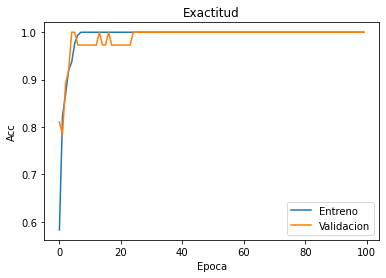

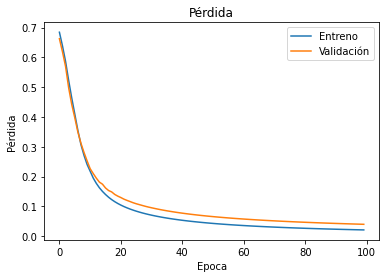

In [21]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [22]:
# red convolucional
model_7 = load_model('Transfer_Adam_partseed=tanh1.h5')

model_7.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_3 (Flatten)          (None, 2048)              0         
_________________________________________________________________
dense_6 (Dense)              (None, 5)                 10245     
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


In [23]:
Y_pred = model_7.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

## 2. Caso aplicado

Ahora probemos nuestro modelo sobre la imagen completa de prueba del paramo ``IMG_3451.JPG``.


In [24]:
from keras.preprocessing import image

img = image.load_img('IMG_3451.JPG')

### 2.1 Red sencilla

In [25]:
# red sencilla 5 neuronas
model_1 = load_model('modelo_redsencilla_initseed=1_part_seed=3numn=5.h5')

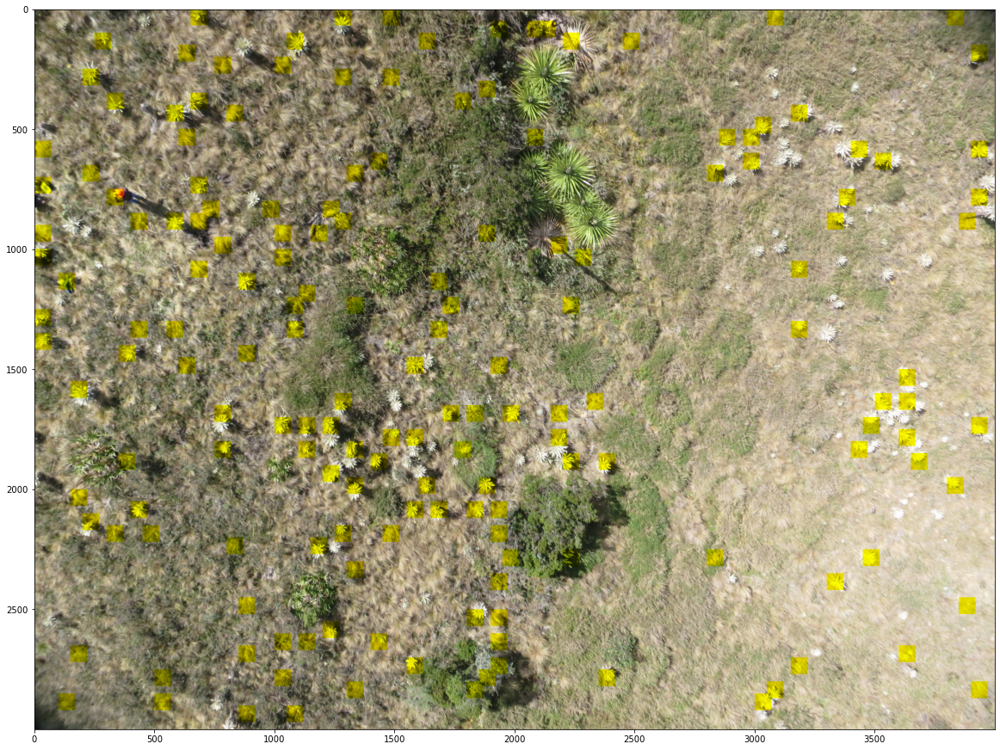

In [26]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_1.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.2 Red multi-capa

In [27]:
# red profunda de 6 capas
model_2 = load_model('modelo_redprofunda_initseed=1_part_seed=8_Init=Normal.h5')

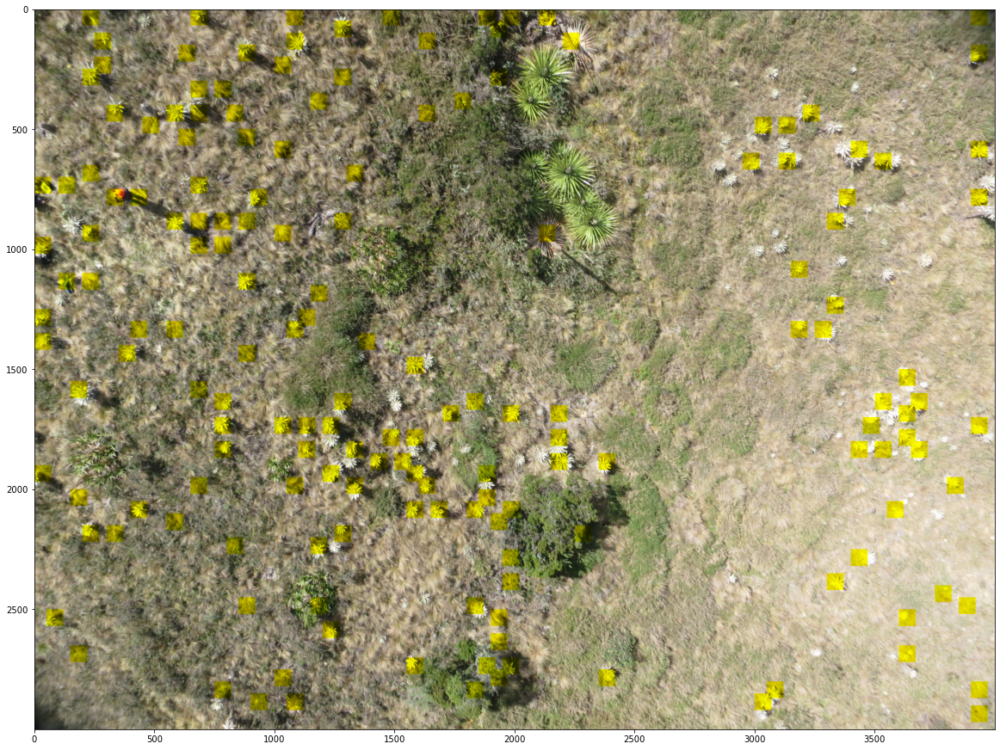

In [28]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_2.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.3 Red Convolucional

In [29]:
# red convolucional sencilla
model_3 = load_model('modelo_CNNdr23.h5')

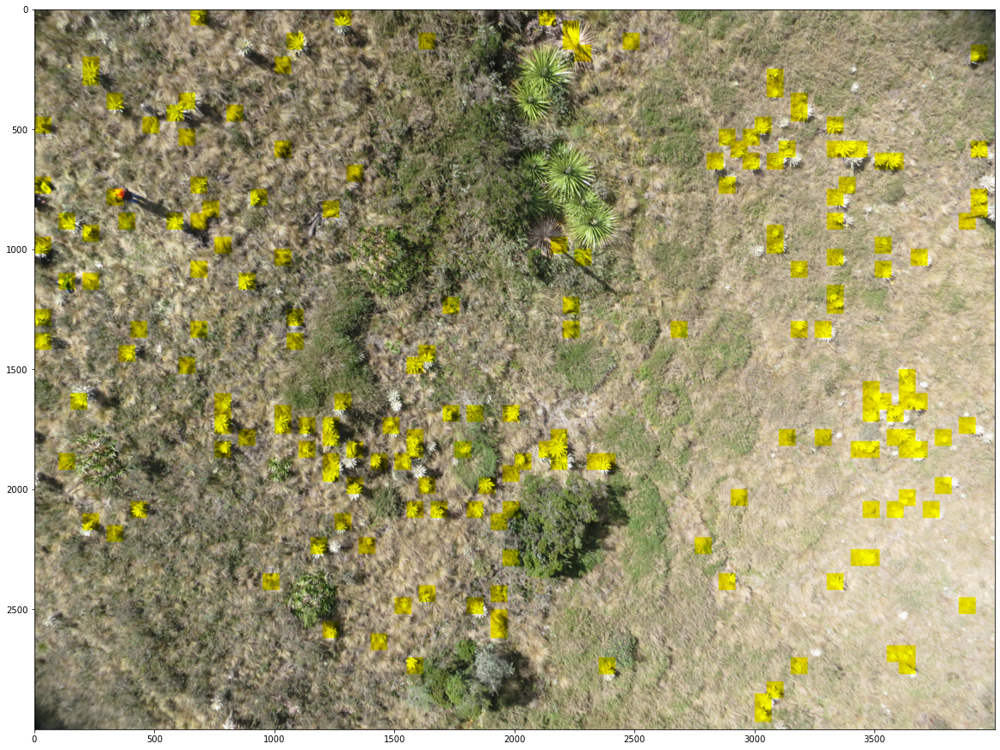

In [30]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_3.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.4 Red Convolucional VGG-16 con transferencia

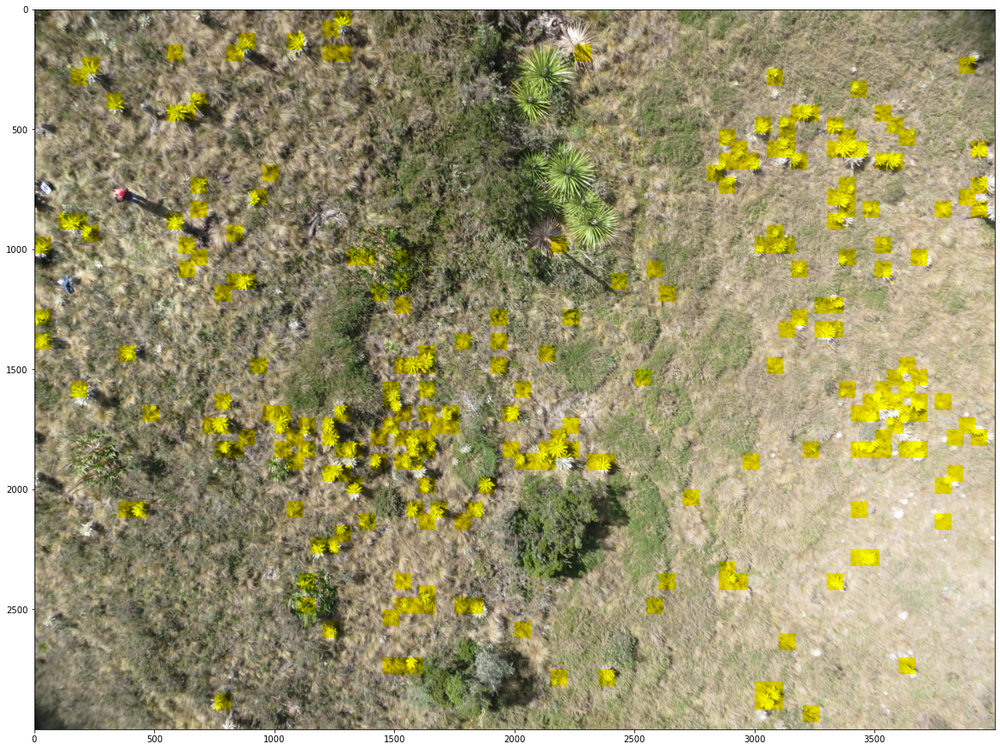

In [31]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model0.predict(subi2)
        Y_preds = model_4.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### Pregunta 2.1

¿Qué puede observar sobre el desempeño de los diferentes modelos? Argumente cuál es el mejor modelo para poner en producción.

Al ver los resultados de la Red Neuronal Sencilla observamos que el modelo logra capturar una buena proporción de los frailejones; sin embargo, existe una buena cantidad de falsos positivos que el modelo identifica como frailejones, pero que no lo son. Ejemplo de lo anterior es que el modelo, puesto en producción, no lograría hacer la distinción entre una persona y un frailejon. 

Ahora, al ver los resultados Red Neuronal Multicapa observamos que la predicción de los frailejones mejora considerablmente con respecto al modelo anterior. No obstante, sigue existiendo porciones de la imagen en donde existen tanto falsos positivos, como falsos negativos. Ejemplo de esto se da al ver que el modelo identifica como un frailejon a la persona en la imagen.

Al comparar estos dos resultados contra una Red Convolucional encontramos una considerable en términos de predicción con un bajo número de falsos positivos y negativos. El único inconveniente que sale a la vista es que el modelo identifica, nuevamente, a la persona como un frailejon.

Finalmente, al mirar los resultados de la Red Convolucional VGG-16 observamos que el modelo logra hacer la distinción entre la persona y el frailejon; sin embargo, se observa un mayor número de falsos negativos en relación con la Red Convolucional.

Dado los resultados de los cuatro modelos, consideramos que el mejor modelo para poner en producción sería el de la Red Neruonal Convolucional porque es el que logra capturar en mejor medida los frailejones en la imagen. Esto incluso a pesar de no lograr hacer la diferencia entre la persona y el frailejon.

### Ejercicio 2.2

Investigue otra red pre-entrenada dsitinta a la VGG-16 e implemente el aprendizaje por transferencia para la deteccion de frailejones. Argumente por qué su justifica el aprendizaje por transferencia con base en el modelo pre-entrenado de su elección (cómo se relacionan la tarea base y la segunda tarea objetivo).

Como primer modelo vamos a implementar el aprendizaje por transferencia utilizando la red VGG-19 (Very Deep Convolutional Networks for Large-Scale Image Recognition (ICLR 2015))

In [32]:
# VGG-19

model1 = applications.VGG19(include_top=False, weights='imagenet')
config_transI = model1.get_config()

In [33]:
VGG19_X = model1.predict(X)

In [34]:
print(VGG19_X.shape, Y.shape)

(250, 2, 2, 512) (1, 250)


In [35]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=VGG19_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

In [36]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(VGG19_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        try:
            pathr =('Transfer_VGG19_Adam_partseed='+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p
        except:
            continue
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.973  | 0.9474 |   99  |
|  1.0   | 0.973  | 0.8947 |   99  |
+--------+--------+--------+-------+


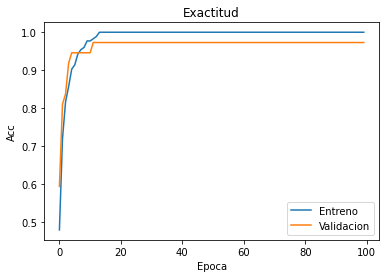

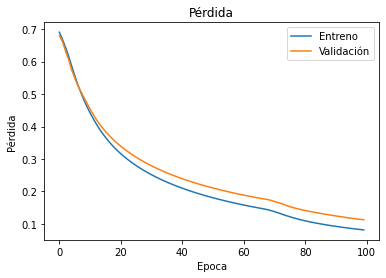

In [37]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [38]:
# red convolucional
model_4A = load_model('Transfer_VGG19_Adam_partseed=1.h5')

model_4A.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_4 (Flatten)          (None, 2048)              0         
_________________________________________________________________
dense_8 (Dense)              (None, 5)                 10245     
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


In [39]:
Y_pred = model_4A.predict(VGG19_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[145,   0],
       [  1, 104]], dtype=int64)

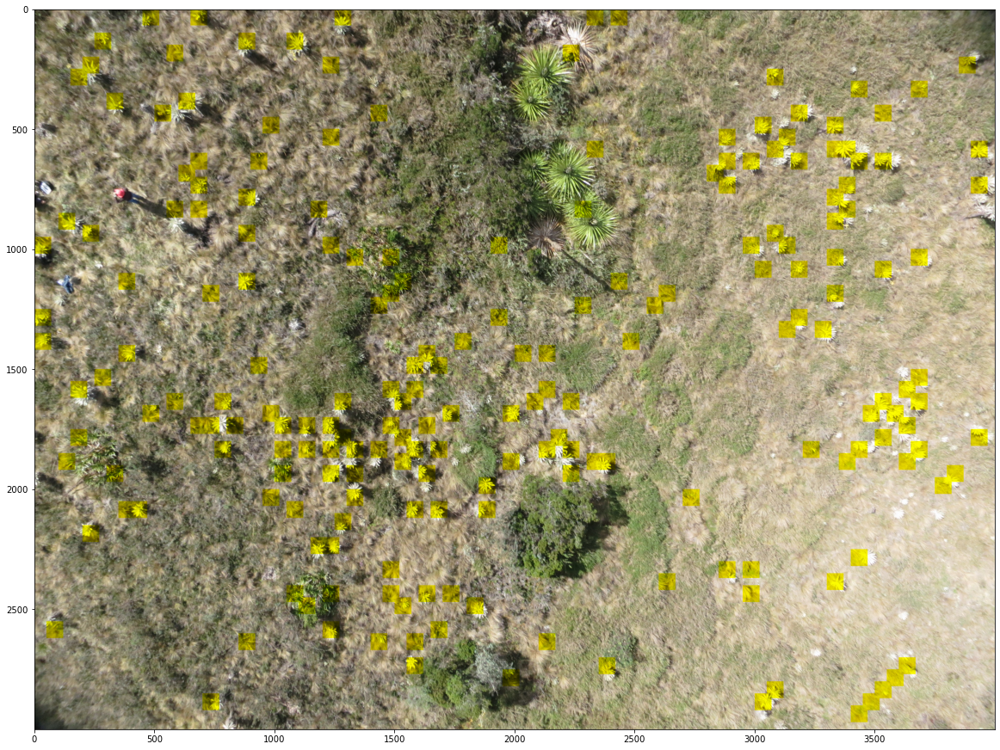

In [40]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model1.predict(subi2)
        Y_preds = model_4A.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [51]:
# ResNet101

model2 = applications.ResNet101(include_top=False, weights='imagenet', input_shape=(70, 70, 3))
config_transI = model2.get_config()

In [52]:
ResNet_X = model2.predict(X)

In [53]:
print(ResNet_X.shape, Y.shape)

(250, 3, 3, 2048) (1, 250)


In [54]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=ResNet_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

In [55]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(ResNet_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        try:
            pathr =('Transfer_RedNet_Adam_partseed='+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p
        except:
            continue
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.7027027010917664 , accu_v2=0.9210526347160339
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697
Epoca= 99 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.9543 | 0.7027 | 0.9211 |   99  |
|  0.6   | 0.4595 | 0.6053 |   0   |
| 0.9257 | 0.8649 | 0.8158 |   99  |
+--------+--------+--------+-------+


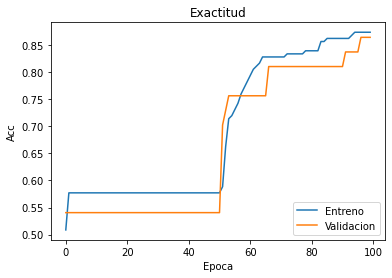

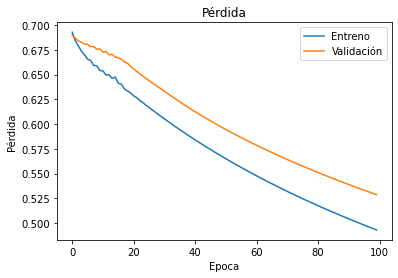

In [56]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [57]:
# red convolucional
model_4B = load_model('Transfer_RedNet_Adam_partseed=3.h5')

model_4B.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_6 (Flatten)          (None, 18432)             0         
_________________________________________________________________
dense_12 (Dense)             (None, 5)                 92165     
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 6         
Total params: 92,171
Trainable params: 92,171
Non-trainable params: 0
_________________________________________________________________


In [58]:
Y_pred = model_4B.predict(ResNet_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[137,   8],
       [ 14,  91]], dtype=int64)

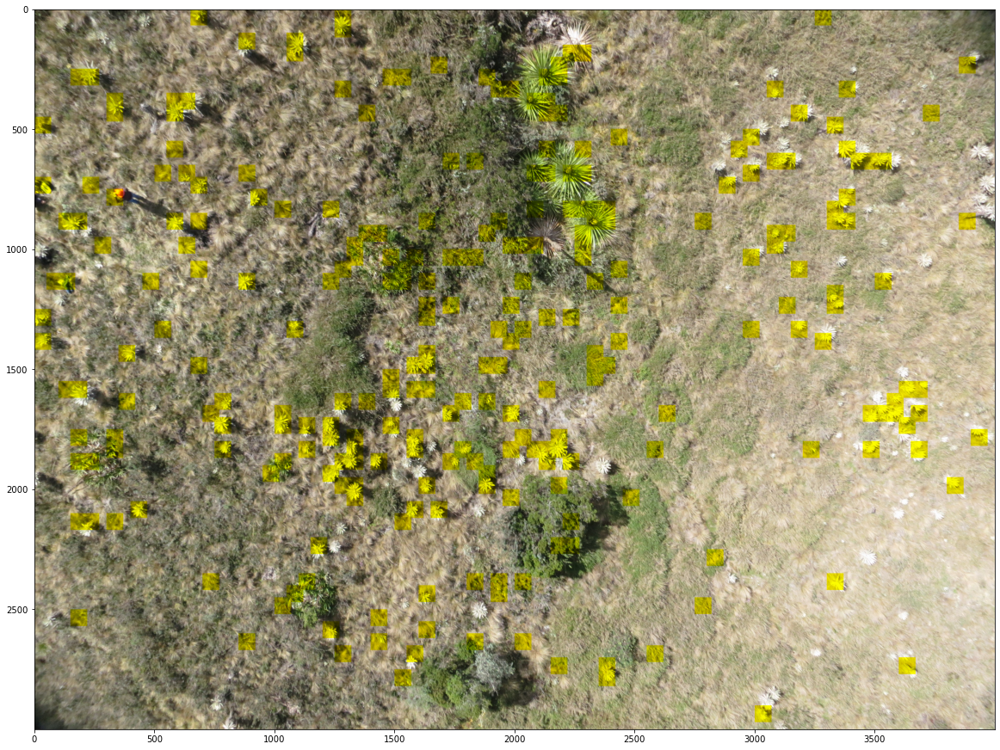

In [61]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model2.predict(subi2)
        Y_preds = model_4B.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [62]:
# Xception

model3 = applications.Xception(include_top=False, weights='imagenet')
config_transI = model3.get_config()

In [63]:
Xcep_X = model3.predict(X)

In [64]:
print(Xcep_X.shape, Y.shape)

(250, 2, 2, 2048) (1, 250)


In [65]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=Xcep_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

In [66]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(Xcep_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        try:
            pathr =('Transfer_Xcep_Adam_partseed='+str(r)+'.h5')
            model.save(pathr) 
            err_p = loss_p
        except:
            continue
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Epoca= 99 , accu_v1=0.9189189076423645 , accu_v2=0.8684210777282715
Epoca= 99 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.9189 | 0.8684 |   99  |
|  1.0   | 0.8919 | 0.8684 |   99  |
+--------+--------+--------+-------+


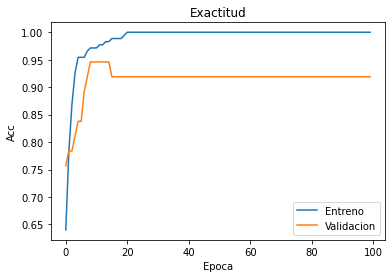

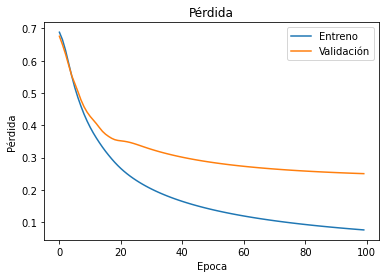

In [67]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

In [68]:
# red convolucional
model_4C = load_model('Transfer_Xcep_Adam_partseed=3.h5')

model_4C.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_7 (Flatten)          (None, 8192)              0         
_________________________________________________________________
dense_14 (Dense)             (None, 5)                 40965     
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 6         
Total params: 40,971
Trainable params: 40,971
Non-trainable params: 0
_________________________________________________________________


In [69]:
Y_pred = model_4C.predict(Xcep_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[142,   3],
       [  5, 100]], dtype=int64)

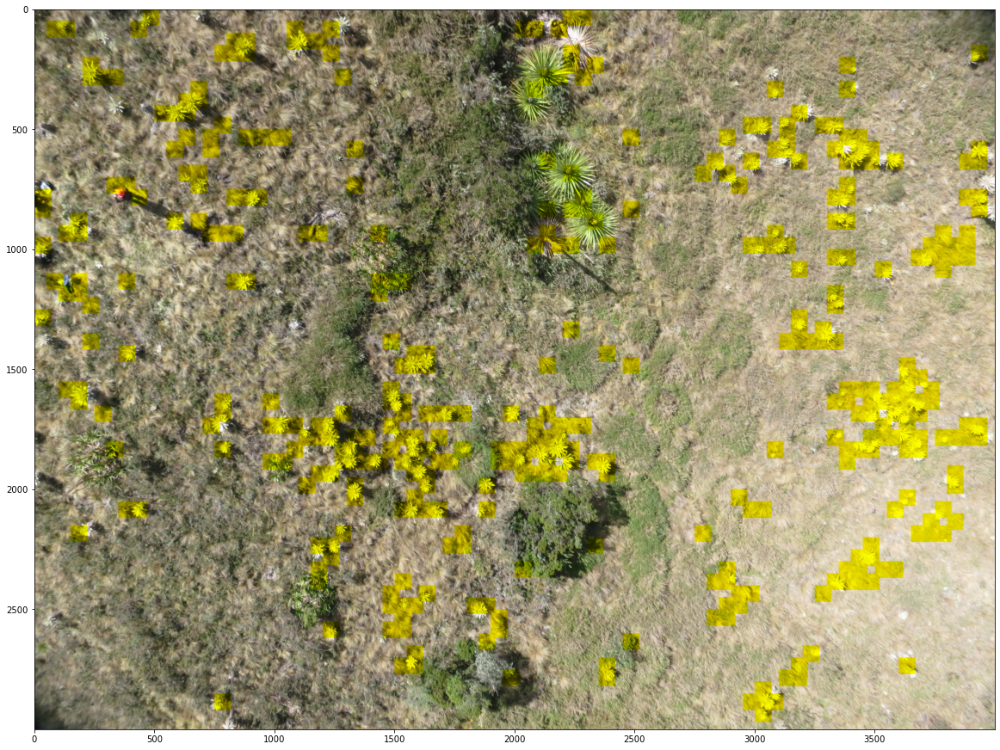

In [70]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model3.predict(subi2)
        Y_preds = model_4C.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

Para la identificación de frailejones implementamos tres modelos adicionales de aprendizaje por transferencia: VGG-19, el cual es similar al VGG1-16 con la diferencia en que se hace uso 19 capas escodidas en vez de 16; ResNet101, el cual utiliza un marco de aprendizaje residual para facilitar la formación de redes que son sustancialmente más profundas (con esto esperamos poder capturar en mejor medida las pequeñas diferencias de color en la imagen que pueden hacer pensar al modelo que un área de color claro es un frailejon); y Xception, el cual utiliza una arquitectura de red neuronal convolucional profunda inspirada en Inception, donde los módulos de Inception han sido reemplazados por convoluciones separables en profundidad (con esto esperamos que las imagenes pre-entrenadas ganen la eficiencia del aprendizaje por tranferencia para poder identificar los frailejones). 

No obstante, tras mirar el rendimiento de los tres modelos encontramos que de los tres propuestos el mejor es el VGG-19 y entre este y los otros modelos desarrollado encontramos que la Red Convolucionan sigue dando el mejor resultado.

### Ejercicio 2.3
Construya un algoritmo que utilice el mejor modelo de red neuronal para la detección de poblaciones en la imagen completa IMG_3451.JPG, y estime la densidad para cada población detectada.

*Ayuda:* Mediante un procedimiento sencillo, primero detecte las poblaciones de frailejones y luego estime su densidad, calculada como el numero de frailejones por area poblada.

Lo primero que hacemos para identificar la densidad de frailejones es determinar el número total que logra predecir el modelo, el cual es igual a 191. 

In [496]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x
fr = 0

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_3.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
            fr = fr + 1
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50

In [497]:
fr

191

Ahora, para cada población detectada, procedemos a partir la imagen en cuadros de 500 por 500 y estimamos cuantos frailejones existen dentro de cada una de estas áreas. Lo anterior se hace asumiendo que cada cuadro representa un área de 9 metros cuadrados.

In [498]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x
fr1 = {}


for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-2550
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr1[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [499]:
fr1

{'0': 0.33,
 '500': 0.44,
 '1000': 0.33,
 '1500': 0.11,
 '2000': 0.44,
 '2500': 0.11,
 '3000': 0.44,
 '3500': 0.11}

En el primer cuadrante se observa una densidad de frailejones media, siendo el máximo igual a 4.

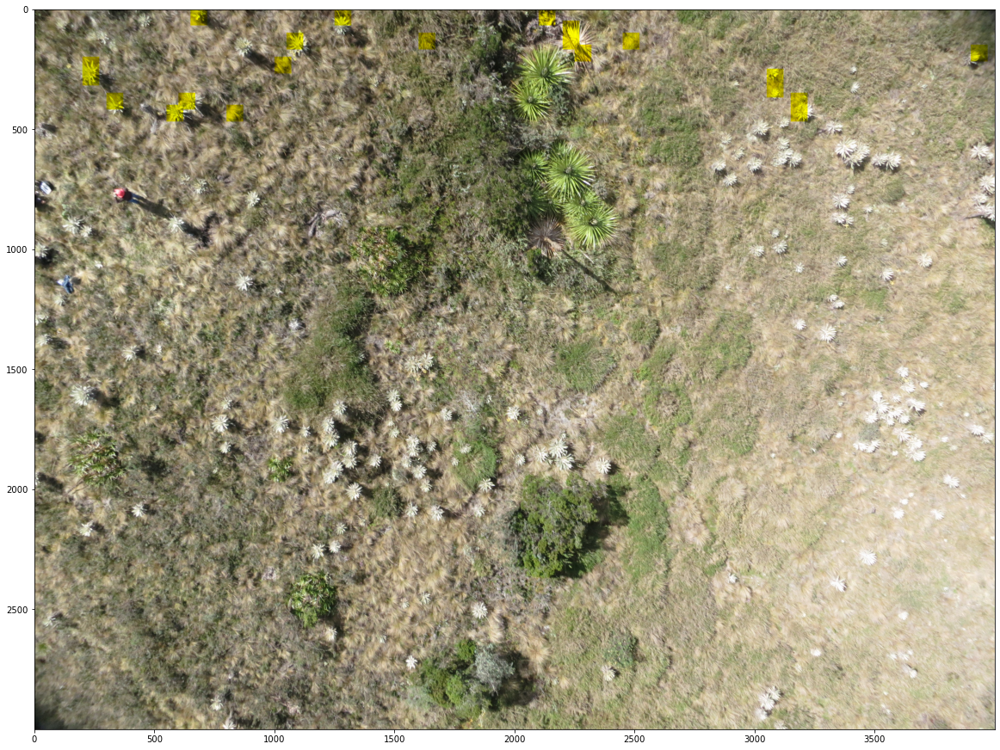

In [500]:
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [501]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)[500:,]
x2 = x
fr2 = {}

for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-2050
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr2[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [502]:
fr2

{'0': 0.56,
 '500': 0.67,
 '1000': 0.56,
 '1500': 0.0,
 '2000': 0.0,
 '2500': 0.33,
 '3000': 1.33,
 '3500': 1.11}

En el segundo cuadrante encontramos que la densidad de frailejones aumenta considerablmente y llega incluso a ser mayor a 9 por metro cuadrado, en especial en la parte derecha superior de la imagen.

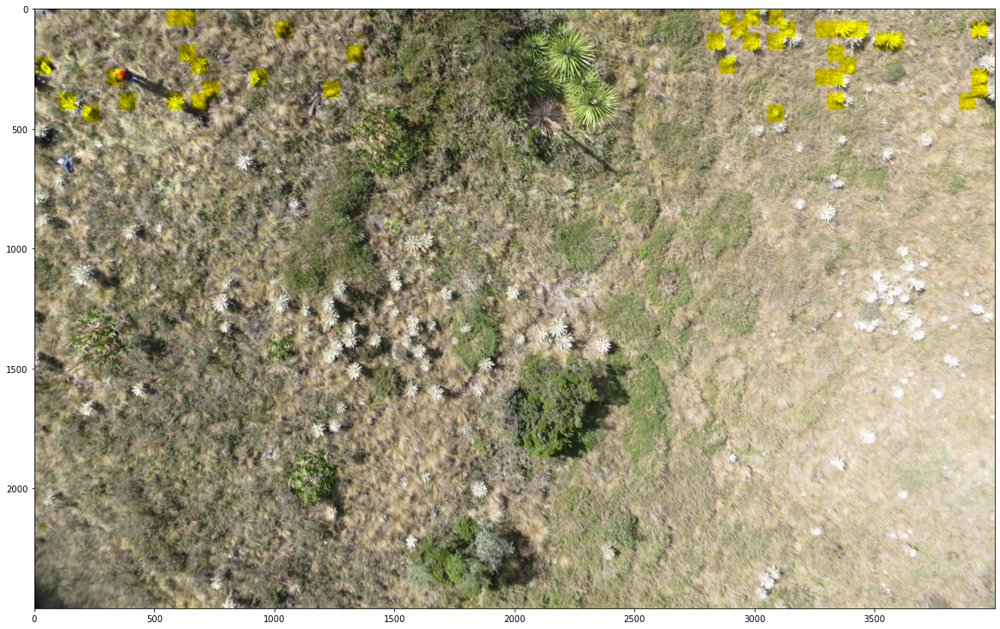

In [503]:
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [504]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)[1000:,]
x2 = x
fr3 = {}

for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-1550
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr3[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [505]:
fr3

{'0': 0.78,
 '500': 0.33,
 '1000': 0.33,
 '1500': 0.22,
 '2000': 0.44,
 '2500': 0.11,
 '3000': 0.89,
 '3500': 0.67}

En el tercer cuadrante vemos que la densidad parece ser proporcional dentro de cada cuadro de 500x500, siendo el número de frailejones existente mayor en la parte izquierda superior.

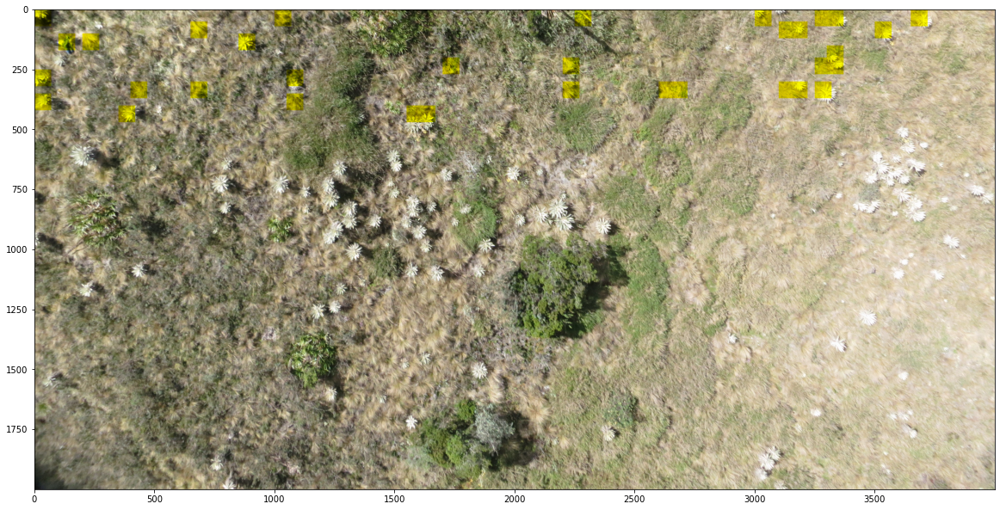

In [506]:
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [507]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)[1500:,]
x2 = x
fr4 = {}

for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-1050
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr4[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [508]:
fr4

{'0': 0.22,
 '500': 0.56,
 '1000': 1.22,
 '1500': 0.78,
 '2000': 1.0,
 '2500': 0.22,
 '3000': 0.33,
 '3500': 2.11}

En el cuarto cuadrante encontramos que la mayor densidad de frailejones se da en la parte derecha de la imagen en donde la predicción es de casi 19 frailejones.

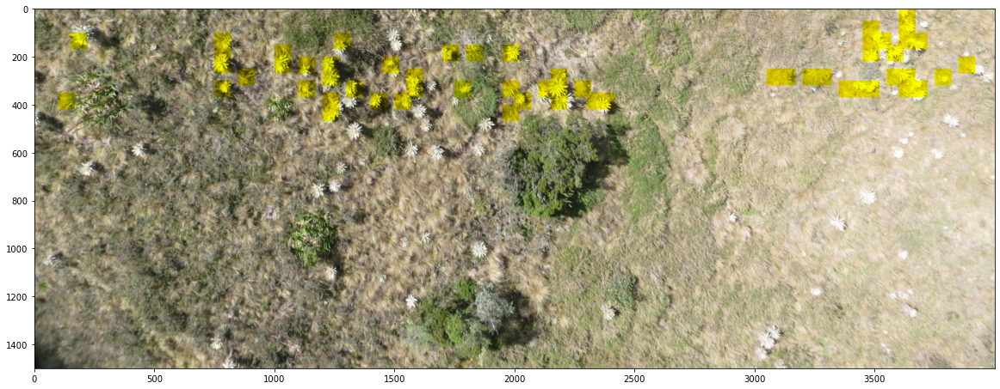

In [509]:
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [510]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)[2000:,]
x2 = x
fr5 = {}

for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-550
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr5[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [511]:
fr5

{'0': 0.33,
 '500': 0.0,
 '1000': 0.56,
 '1500': 0.67,
 '2000': 0.11,
 '2500': 0.44,
 '3000': 0.56,
 '3500': 0.89}

En el quinto cuadrante observamos que la densidad es relativamente menor en comparación con los demos cuadrantes, siendo el de mayor densidad igual a 0.89.

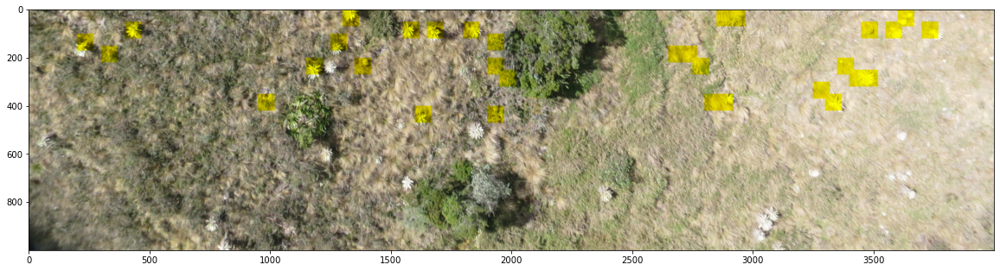

In [512]:
plt.figure(figsize = (20,20))
plt.imshow(x2)

In [513]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)[2500:,]
x2 = x
fr6 = {}

for a in range(3500, -500, -500):
    tmp = 0
    ni = x.shape[0]-50
    mi = x.shape[1]-a-50

    f1=0
    f2=70
    for i in range(1,ni,50):
        c1=0
        c2=70
        for j in range(1,mi,50):
            subi=x[f1:f2,c1:c2,]/255.
            subi2=np.expand_dims(subi,0)
            Y_preds = model_3.predict(subi2)
            pred_P = (Y_preds > 0.5)
            if(pred_P==1):
                x2[f1:f2,c1:c2,2]=0
                tmp = tmp + 1
            c1=c1+50
            c2=c2+50
        f1=f1+50
        f2=f2+50
    
    fr6[str(abs(a-3500))] = round(tmp/9, ndigits = 2)

In [514]:
fr6

{'0': 0.0,
 '500': 0.0,
 '1000': 0.22,
 '1500': 0.44,
 '2000': 0.11,
 '2500': 0.0,
 '3000': 0.44,
 '3500': 0.56}

Finalmente, el sexto cuadrante es donde se encuentra la menor cantidad de predicciones de frailejones.

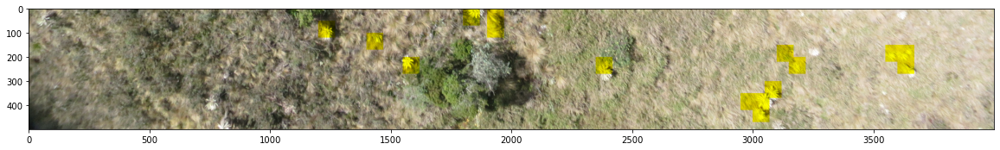

In [515]:
plt.figure(figsize = (20,20))
plt.imshow(x2)